In [22]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt 
from urllib.parse import urlparse
import re
import whois
import datetime
import urllib

In [16]:
df = pd.read_csv('./dataset/phishing_site_urls.csv')

In [17]:
df.head()

,URL,Label
0,nobell.it/70ffb52d079109dca5664cce6f317373782/...,bad
1,www.dghjdgf.com/paypal.co.uk/cycgi-bin/webscrc...,bad
2,serviciosbys.com/paypal.cgi.bin.get-into.herf....,bad
3,mail.printakid.com/www.online.americanexpress....,bad
4,thewhiskeydregs.com/wp-content/themes/widescre...,bad


In [8]:
df.shape

(549346, 3)

In [14]:
# def domain(url):
#     parsed_url = urlparse(url)
#     print(parsed_url.hostname)
#     domain = parsed_url.netloc
#     print(domain)
#     return domain

In [7]:
# df['domain_name'] = df['URL'].apply(domain)

In [18]:
df['url_len'] = df['URL'].apply(lambda x: len(str(x)))

In [23]:
def count_special_characters(url):
    # Define the special characters to count
    special_chars = "!#$%&'()*+,-./:;<=>?@[\\]^_`{|}~"
    
    # Parse the URL to separate its components
    parsed_url = urllib.parse.urlparse(url)
    
    # Combine all the parts of the URL into one string
    combined_url = (parsed_url.scheme + parsed_url.netloc +
                    parsed_url.path + parsed_url.params +
                    parsed_url.query + parsed_url.fragment)
    
    # Count special characters
    count = sum(1 for char in combined_url if char in special_chars)
    
    return count

In [26]:

df['char_count'] = df['URL'].apply(count_special_characters)

In [37]:
def has_ip_address(url):
    domain = urlparse(url).netloc
    has_ip_address = bool(re.match(r'\b(?:\d{1,3}\.){3}\d{1,3}\b', domain))
    return int(has_ip_address)

In [38]:
df['has_ip_address'] = df['URL'].apply(has_ip_address)

In [39]:
df.head()

,URL,Label,url_len,char_count,has_ip_address
0,nobell.it/70ffb52d079109dca5664cce6f317373782/...,bad,225,31,0
1,www.dghjdgf.com/paypal.co.uk/cycgi-bin/webscrc...,bad,81,15,0
2,serviciosbys.com/paypal.cgi.bin.get-into.herf....,bad,177,19,0
3,mail.printakid.com/www.online.americanexpress....,bad,60,8,0
4,thewhiskeydregs.com/wp-content/themes/widescre...,bad,116,12,0


In [42]:
df['has_ip_address'].value_counts()

has_ip_address
0    549339
1         7
Name: count, dtype: int64

In [56]:
def https_secured(url):
    htp = urlparse(url).scheme
    if str(htp) == 'https':
         return 1
    else:
         return 0

In [58]:
df['https'] = df['URL'].apply(https_secured)

In [60]:
df['https'].value_counts()

https
0    549339
1         7
Name: count, dtype: int64

In [67]:
def redirects_url(url):
    parsed_url = urlparse(url)    
    redirects = 1 if parsed_url.query else 0
    return redirects

In [74]:
redirects_url(df['URL'].iloc[6])

0

In [75]:
df['redirects_url'] = df['URL'].apply(redirects_url)

In [76]:
def count_special_chars(url):
    return len(re.findall(r'[-_&]', url))

def count_suspicious_chars(url):
    return len(re.findall(r'[!@#$%^&*()_+={}\[\]:;"\'<>,.?/|\\]', url))

In [77]:
df['special_chars'] = df['URL'].apply(count_special_chars)
df['suspicious_chars'] = df['URL'].apply(count_suspicious_chars)

In [79]:
df['url_syntax_valid'] = df['URL'].apply(lambda url: 1 if re.match(r'^https?://', url) else 0)

In [80]:
df['url_syntax_valid'].value_counts()

url_syntax_valid
0    549239
1       107
Name: count, dtype: int64

In [101]:
def reg_length(url):
    try:
        domain = urlparse(url).netloc
        domain_whois = whois.whois(domain)
        
        # Handle list of dates, take the first one
        creation_date = domain_whois.creation_date
        expiration_date = domain_whois.expiration_date

        # Check if these are lists and take the first element if so
        if isinstance(creation_date, list):
            # print("creation_date : ",creation_date)
            creation_date = creation_date[0]
        if isinstance(expiration_date, list):
            # print("expiration_date : ",expiration_date)
            expiration_date = expiration_date[0]


        # Ensure the dates are datetime objects
        if isinstance(creation_date, str):
            creation_date = pd.to_datetime(creation_date)
        if isinstance(expiration_date, str):
            expiration_date = pd.to_datetime(expiration_date)
        
        # Calculate registration length in days
        registration_length = (expiration_date - creation_date).days
    except Exception as e:
        print(e)
        registration_length = -1 
    finally:
        return registration_length



In [111]:
reg_length(df['URL'].iloc[101111])
           

unsupported operand type(s) for -: 'NoneType' and 'NoneType'


-1

In [112]:
df['reg_length'] = df['URL'].apply(reg_length)

unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type

2024-05-16 13:55:13,461 - whois.whois - ERROR - Error trying to connect to socket: closing socket - timed out


unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type

2024-05-16 13:55:57,252 - whois.whois - ERROR - Error trying to connect to socket: closing socket - timed out


unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type

2024-05-16 13:56:06,298 - whois.whois - ERROR - Error trying to connect to socket: closing socket - [Errno -2] Name or service not known


unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type

2024-05-16 13:56:06,904 - whois.whois - ERROR - Error trying to connect to socket: closing socket - [Errno -2] Name or service not known


unsupported operand type(s) for -: 'NoneType' and 'NoneType'


2024-05-16 13:56:07,755 - whois.whois - ERROR - Error trying to connect to socket: closing socket - [Errno -2] Name or service not known


unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type

2024-05-16 13:56:25,833 - whois.whois - ERROR - Error trying to connect to socket: closing socket - [Errno -2] Name or service not known


unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type

2024-05-16 13:59:14,717 - whois.whois - ERROR - Error trying to connect to socket: closing socket - timed out


unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type

2024-05-16 13:59:22,135 - whois.whois - ERROR - Error trying to connect to socket: closing socket - [Errno -2] Name or service not known


unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type

2024-05-16 13:59:34,405 - whois.whois - ERROR - Error trying to connect to socket: closing socket - timed out


unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type

2024-05-16 14:01:38,937 - whois.whois - ERROR - Error trying to connect to socket: closing socket - timed out


unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type(s) for -: 'NoneType' and 'NoneType'
unsupported operand type

In [114]:
df['js_presence'] =  df['URL'].apply(lambda url : 1 if '.js' in url else 0)

In [116]:
df['js_presence'].value_counts()

js_presence
0    547551
1      1795
Name: count, dtype: int64

In [117]:
df['Label'].value_counts()

Label
good    392924
bad     156422
Name: count, dtype: int64

In [123]:
def letter_count(URL: str) -> int:
    letters = 0
    for i in URL:
        if i.isalpha():
            letters = letters + 1
    return letters


135

In [126]:
df['letters'] = df['URL'].apply(lambda x: letter_count(x))


In [128]:
def digit_count(URL: str) -> int:
    digits = 0
    for i in URL:
        if i.isnumeric():
            digits = digits + 1
    return digits

In [129]:
df['digits']  = df['URL'].apply(lambda x: digit_count(x))

In [121]:
encodings = {"good" : 0 , "bad" : 1}
df['classes'] = df['Label'].map(encodings)

In [175]:
df.head()

,URL,Label,url_len,char_count,has_ip_address,https,redirects_url,special_chars,suspicious_chars,url_syntax_valid,reg_length,js_presence,classes,letters,digits
0,nobell.it/70ffb52d079109dca5664cce6f317373782/...,bad,225,31,0,0,1,11,28,0,-1,0,1,135,58
1,www.dghjdgf.com/paypal.co.uk/cycgi-bin/webscrc...,bad,81,15,0,0,0,4,13,0,-1,0,1,65,1
2,serviciosbys.com/paypal.cgi.bin.get-into.herf....,bad,177,19,0,0,0,1,18,0,-1,0,1,111,47
3,mail.printakid.com/www.online.americanexpress....,bad,60,8,0,0,0,0,8,0,-1,0,1,52,0
4,thewhiskeydregs.com/wp-content/themes/widescre...,bad,116,12,0,0,1,1,12,0,-1,0,1,82,21


## Visulaize Data

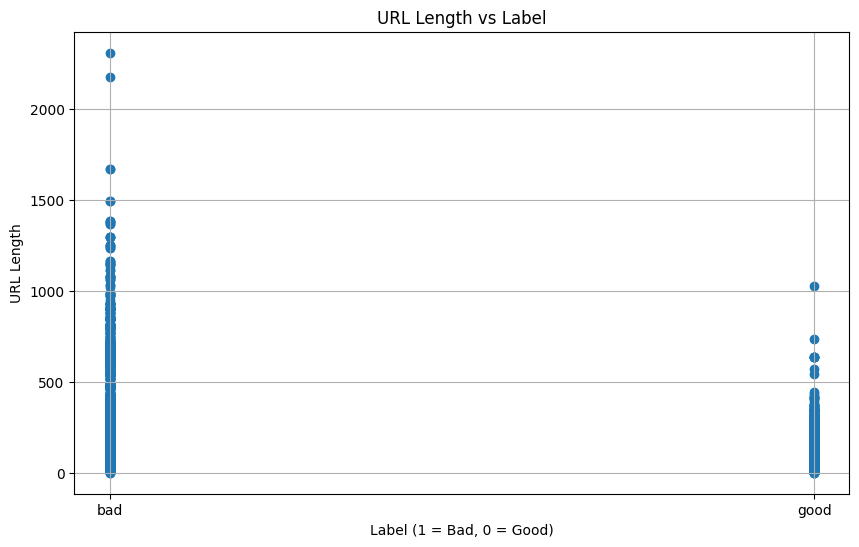

In [133]:
plt.figure(figsize=(10, 6))
plt.scatter(df['Label'], df['url_len'])
plt.xlabel('Label (1 = Bad, 0 = Good)')
plt.ylabel('URL Length')

plt.title('URL Length vs Label')
plt.grid(True)
plt.show()

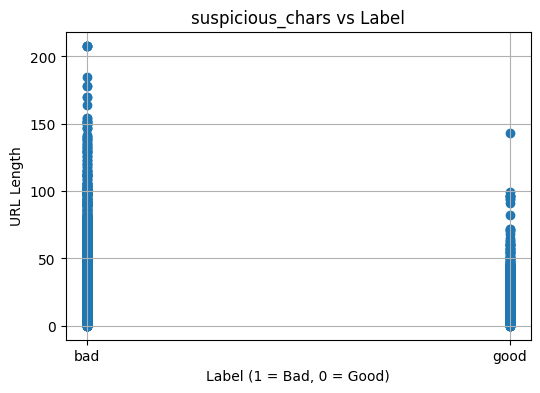

In [137]:
plt.figure(figsize=(6, 4))
plt.scatter(df['Label'], df['suspicious_chars'])
plt.xlabel('Label (1 = Bad, 0 = Good)')
plt.ylabel('URL Length')

plt.title('suspicious_chars vs Label')
plt.grid(True)
plt.show()

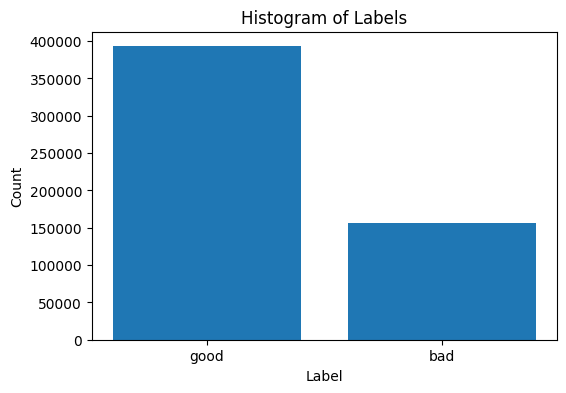

In [139]:
# Count the occurrences of each label
label_counts = df['Label'].value_counts()

# Plot the histogram
plt.figure(figsize=(6, 4))
plt.bar(label_counts.index, label_counts.values)
plt.xlabel('Label')
plt.ylabel('Count')
plt.title('Histogram of Labels')
plt.show()

In [158]:
df['Label'].value_counts()

Label
good    392924
bad     156422
Name: count, dtype: int64

In [144]:
df.columns

Index(['URL', 'Label', 'url_len', 'char_count', 'has_ip_address', 'https',
       'redirects_url', 'special_chars', 'suspicious_chars',
       'url_syntax_valid', 'reg_length', 'js_presence', 'classes', 'letters',
       'digits'],
      dtype='object')

In [214]:
def path_len(url):
    try:
        parsed_url = urlparse(url)
        # Extract path
        path = parsed_url.path
        return len(str(path))
    except:
        return 0

In [215]:
df['path_len'] = df['URL'].apply(path_len)

In [216]:
df.head()

,URL,Label,url_len,char_count,has_ip_address,https,redirects_url,special_chars,suspicious_chars,url_syntax_valid,reg_length,js_presence,classes,letters,digits,path_len
0,nobell.it/70ffb52d079109dca5664cce6f317373782/...,bad,225,31,0,0,1,11,28,0,-1,0,1,135,58,134
1,www.dghjdgf.com/paypal.co.uk/cycgi-bin/webscrc...,bad,81,15,0,0,0,4,13,0,-1,0,1,65,1,81
2,serviciosbys.com/paypal.cgi.bin.get-into.herf....,bad,177,19,0,0,0,1,18,0,-1,0,1,111,47,177
3,mail.printakid.com/www.online.americanexpress....,bad,60,8,0,0,0,0,8,0,-1,0,1,52,0,60
4,thewhiskeydregs.com/wp-content/themes/widescre...,bad,116,12,0,0,1,1,12,0,-1,0,1,82,21,79


In [217]:
df['path_ratio'] = df['path_len'] / df['url_len']

In [218]:
df.head()

,URL,Label,url_len,char_count,has_ip_address,https,redirects_url,special_chars,suspicious_chars,url_syntax_valid,reg_length,js_presence,classes,letters,digits,path_len,path_ratio
0,nobell.it/70ffb52d079109dca5664cce6f317373782/...,bad,225,31,0,0,1,11,28,0,-1,0,1,135,58,134,0.595556
1,www.dghjdgf.com/paypal.co.uk/cycgi-bin/webscrc...,bad,81,15,0,0,0,4,13,0,-1,0,1,65,1,81,1.000000
2,serviciosbys.com/paypal.cgi.bin.get-into.herf....,bad,177,19,0,0,0,1,18,0,-1,0,1,111,47,177,1.000000
3,mail.printakid.com/www.online.americanexpress....,bad,60,8,0,0,0,0,8,0,-1,0,1,52,0,60,1.000000
4,thewhiskeydregs.com/wp-content/themes/widescre...,bad,116,12,0,0,1,1,12,0,-1,0,1,82,21,79,0.681034


In [176]:
df_good = df[df['Label'] == 'good']
df_bad = df[df['Label'] == 'bad']

In [177]:
df_good.head()

,URL,Label,url_len,char_count,has_ip_address,https,redirects_url,special_chars,suspicious_chars,url_syntax_valid,reg_length,js_presence,classes,letters,digits
18231,esxcc.com/js/index.htm?us.battle.net/noghn/en/...,good,571,75,0,0,1,9,70,0,-1,0,0,308,41
18232,wwweira¯&nvinip¿ncH¯wVö%ÆåyDaHðû/ÏyEùuË\nÓ6...,good,352,42,0,0,0,5,40,0,-1,0,0,175,21
18233,'www.institutocgr.coo/web/media/syqvem/dk-óij...,good,337,41,0,0,1,5,38,0,-1,0,0,174,18
18234,Yìê koãÕ»Î§DéÎl½ñ¡ââqtò¸/à; Í,good,33,1,0,0,0,0,2,0,-1,0,0,20,1
18236,ruta89fm.com/images/AS@Vies/1i75cf7b16vc<Fd16...,good,316,37,0,0,1,2,32,0,-1,0,0,148,35


In [160]:
df_good.shape

(392924, 15)

In [178]:
df_bad.head()

,URL,Label,url_len,char_count,has_ip_address,https,redirects_url,special_chars,suspicious_chars,url_syntax_valid,reg_length,js_presence,classes,letters,digits
0,nobell.it/70ffb52d079109dca5664cce6f317373782/...,bad,225,31,0,0,1,11,28,0,-1,0,1,135,58
1,www.dghjdgf.com/paypal.co.uk/cycgi-bin/webscrc...,bad,81,15,0,0,0,4,13,0,-1,0,1,65,1
2,serviciosbys.com/paypal.cgi.bin.get-into.herf....,bad,177,19,0,0,0,1,18,0,-1,0,1,111,47
3,mail.printakid.com/www.online.americanexpress....,bad,60,8,0,0,0,0,8,0,-1,0,1,52,0
4,thewhiskeydregs.com/wp-content/themes/widescre...,bad,116,12,0,0,1,1,12,0,-1,0,1,82,21


In [161]:
from sklearn.utils import resample

df_majority_downsampled = resample(df_good, 
                                   replace=False,    # sample without replacement
                                   n_samples=len(df_bad),     # to match minority class
                                   random_state=42) 

In [179]:
df_majority_downsampled.head()

,URL,Label,url_len,char_count,has_ip_address,https,redirects_url,special_chars,suspicious_chars,url_syntax_valid,reg_length,js_presence,classes,letters,digits
313746,depositaccounts.com/savings/,good,28,3,0,0,0,0,3,0,-1,0,0,25,0
305419,citypages.com/related/to/Dave+Simonett/,good,39,6,0,0,0,0,6,0,-1,0,0,33,0
284414,askart.com/askart/c/kate_carew/kate_carew.aspx,good,46,8,0,0,0,2,8,0,-1,0,0,38,0
153114,brianwattsphoto.com/,good,20,2,0,0,0,0,2,0,-1,0,0,18,0
444475,thefreedictionary.com/action+deferred,good,37,3,0,0,0,0,3,0,-1,0,0,34,0


In [180]:
df_majority_downsampled.shape

(156422, 15)

In [166]:
df_bad.shape

(156422, 15)

In [181]:
new_df = pd.concat([df_majority_downsampled, df_bad], axis=0)

In [182]:
new_df.head()

,URL,Label,url_len,char_count,has_ip_address,https,redirects_url,special_chars,suspicious_chars,url_syntax_valid,reg_length,js_presence,classes,letters,digits
313746,depositaccounts.com/savings/,good,28,3,0,0,0,0,3,0,-1,0,0,25,0
305419,citypages.com/related/to/Dave+Simonett/,good,39,6,0,0,0,0,6,0,-1,0,0,33,0
284414,askart.com/askart/c/kate_carew/kate_carew.aspx,good,46,8,0,0,0,2,8,0,-1,0,0,38,0
153114,brianwattsphoto.com/,good,20,2,0,0,0,0,2,0,-1,0,0,18,0
444475,thefreedictionary.com/action+deferred,good,37,3,0,0,0,0,3,0,-1,0,0,34,0


In [183]:
X = new_df.drop(columns=['URL', 'Label', 'classes'])
Y = new_df['classes']

In [184]:
X.shape

(312844, 12)

In [185]:
X.head()

,url_len,char_count,has_ip_address,https,redirects_url,special_chars,suspicious_chars,url_syntax_valid,reg_length,js_presence,letters,digits
313746,28,3,0,0,0,0,3,0,-1,0,25,0
305419,39,6,0,0,0,0,6,0,-1,0,33,0
284414,46,8,0,0,0,2,8,0,-1,0,38,0
153114,20,2,0,0,0,0,2,0,-1,0,18,0
444475,37,3,0,0,0,0,3,0,-1,0,34,0


In [186]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaled_data = scaler.fit_transform(X)
scaled_df = pd.DataFrame(scaled_data, columns=X.columns)

In [187]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size = 0.2,stratify=Y ,shuffle=True, random_state=5)

In [188]:
from sklearn.linear_model import LogisticRegression

classifier1 = LogisticRegression(max_iter=1000, random_state=0)
classifier1.fit(X_train.values, y_train.values)
y_pred1 = classifier1.predict(X_test.values)

In [189]:
from sklearn.metrics import accuracy_score

accuracy1 = accuracy_score(y_test, y_pred1)
print("Accuracy1:", accuracy1)

Accuracy1: 0.6364493599066631


In [190]:
import pandas as pd
import numpy as np

import time

import keras

from tensorflow.keras import Sequential,layers, activations
import tensorflow as tf
from keras.utils import to_categorical
import time

from sklearn.model_selection import train_test_split

2024-05-16 16:02:05.387702: I external/local_tsl/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-05-16 16:02:05.618458: I external/local_tsl/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-05-16 16:02:06.454887: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-05-16 16:02:15.222563: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [192]:
X.shape

(312844, 12)

In [193]:
model = Sequential()
model.add(layers.Dense(256, input_shape=(12,), activation="relu"))
model.add(layers.Dropout(0.3))
model.add(layers.Dense(128, activation="relu"))
model.add(layers.Dropout(0.3))
model.add(layers.Dense(64, activation="relu"))
model.add(layers.Dropout(0.3))
model.add(layers.Dense(1, activation="sigmoid"))  # Sigmoid for binary classification

model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
              loss="binary_crossentropy",  # Binary classification loss
              metrics=["accuracy"])  # Accuracy is common for binary classification

model.summary()

/home/muxair/Desktop/phishing_urls/venv/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_4 (Dense)                 │ (None, 256)            │         3,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 44,545 (174.00 KB)

 Trainable params: 44,545 (174.00 KB)

 Non-trainable params: 0 (0.00 B)

In [194]:
h = model.fit(X_train, y_train, verbose = 2, validation_split=0.2, epochs= 50)

Epoch 1/50
6257/6257 - 28s - 5ms/step - accuracy: 0.6628 - loss: 0.5854 - val_accuracy: 0.7328 - val_loss: 0.5063
Epoch 2/50
6257/6257 - 27s - 4ms/step - accuracy: 0.7275 - loss: 0.5156 - val_accuracy: 0.7415 - val_loss: 0.4865
Epoch 3/50
6257/6257 - 26s - 4ms/step - accuracy: 0.7359 - loss: 0.5071 - val_accuracy: 0.7450 - val_loss: 0.4884
Epoch 4/50
6257/6257 - 27s - 4ms/step - accuracy: 0.7386 - loss: 0.5018 - val_accuracy: 0.7527 - val_loss: 0.4792
Epoch 5/50
6257/6257 - 25s - 4ms/step - accuracy: 0.7399 - loss: 0.5004 - val_accuracy: 0.7573 - val_loss: 0.4767
Epoch 6/50
6257/6257 - 25s - 4ms/step - accuracy: 0.7409 - loss: 0.4979 - val_accuracy: 0.7467 - val_loss: 0.4868
Epoch 7/50
6257/6257 - 27s - 4ms/step - accuracy: 0.7426 - loss: 0.4957 - val_accuracy: 0.7560 - val_loss: 0.4758
Epoch 8/50
6257/6257 - 38s - 6ms/step - accuracy: 0.7432 - loss: 0.4951 - val_accuracy: 0.7550 - val_loss: 0.4750
Epoch 9/50
6257/6257 - 36s - 6ms/step - accuracy: 0.7437 - loss: 0.4938 - val_accuracy: 

In [208]:
from sklearn.metrics import confusion_matrix
pred = model.predict(X_test)
# print(pred)
y_pred = pred.flatten()
print(y_pred.round())

1956/1956 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step
[1. 0. 1. ... 0. 0. 0.]


In [209]:
y_pred = y_pred.round().tolist()
y_pred = [int(i) for i in y_pred]

In [210]:
y_pred

[1,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 1,


In [200]:
y_test.tolist()

[1,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 1,


In [213]:
# y_test_class = np.argmax(y_test, axis=1)
cm =confusion_matrix(y_test.tolist(), y_pred)
print(cm)

print()
from sklearn.metrics import classification_report
report = classification_report(y_test.tolist(), y_pred)
print(report)

[[25134  6150]
 [ 9602 21683]]

              precision    recall  f1-score   support

           0       0.72      0.80      0.76     31284
           1       0.78      0.69      0.73     31285

    accuracy                           0.75     62569
   macro avg       0.75      0.75      0.75     62569
weighted avg       0.75      0.75      0.75     62569

